<a href="https://colab.research.google.com/github/lollcat/annealed_flow_transport/blob/craft-update/craft_gmm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/lollcat/annealed_flow_transport.git

fatal: destination path 'annealed_flow_transport' already exists and is not an empty directory.


In [2]:
import os
os.chdir("annealed_flow_transport")

In [3]:
!git checkout craft-update
!git pull

Already on 'craft-update'
Your branch is up to date with 'origin/craft-update'.
remote: Enumerating objects: 7, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (1/1), done.
remote: Total 4 (delta 3), reused 4 (delta 3), pack-reused 0
Unpacking objects: 100% (4/4), 404 bytes | 404.00 KiB/s, done.
From https://github.com/lollcat/annealed_flow_transport
   7787854..3fb28fe  craft-update -> origin/craft-update
Updating 7787854..3fb28fe
Fast-forward
 annealed_flow_transport/densities.py | 8 ++++----
 1 file changed, 4 insertions(+), 4 deletions(-)


In [4]:
!pip install chex==0.1.5 ml_collections optax dm-haiku distrax -q

In [5]:
from annealed_flow_transport.train import run_experiment
from evaluation import make_forward_pass_func, load_checkpoint
from evaluation import evaluate_mog as evaluate
import numpy as np
import numpy as np
import jax

In [6]:
from jax.config import config
config.update("jax_enable_x64", True)

In [7]:
from configs.fab_mog import get_config

In [8]:
exp_config = get_config()

# Train

### Run first seed

In [9]:
exp_config.seed = 1
exp_config.params_filename = "checkpoint_seed1"

In [10]:
results = run_experiment(exp_config)

AttributeError: ignored

In [ ]:
filename = "checkpoint_seed1"
transition_params = load_checkpoint(filename)
forward_pass_function = make_forward_pass_func(exp_config, transition_params=transition_params)
eval_info = evaluate(forward_pass_function)
print(eval_info)

/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:144: FutureWarning: jax.tree_flatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_flatten instead.
  leaves, treedef = jax.tree_flatten(tree)
/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:145: FutureWarning: jax.tree_unflatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_unflatten instead.
  return jax.tree_unflatten(treedef, leaves)


{'ess': DeviceArray(0.55779843, dtype=float64), 'bias': 0.9882634362142643, 'bias_unweighted': 0.9911261525842887}


In [ ]:
import numpy as np
import jax
particle_state = forward_pass_function(jax.random.PRNGKey(0))
samples = np.array(particle_state.samples)
np.save(open(f"samples_seed{exp_config.seed}.np", "wb"), samples)

### Run second seed

In [ ]:
exp_config.seed = 2
exp_config.params_filename = "checkpoint_seed2"

/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:144: FutureWarning: jax.tree_flatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_flatten instead.
  leaves, treedef = jax.tree_flatten(tree)
/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:145: FutureWarning: jax.tree_unflatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_unflatten instead.
  return jax.tree_unflatten(treedef, leaves)
  0%|          | 0/78125 [00:00<?, ?it/s]

Step 0: Free energy 16.785056835574625 Log Normalizer estimate -8.036573293851916


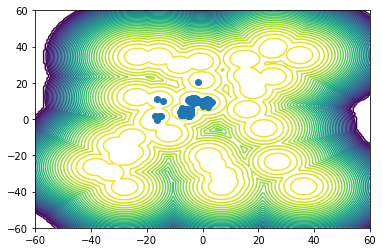

  1%|▏         | 999/78125 [00:15<17:54, 71.77it/s]

Step 1000: Free energy 6.426089512397995 Log Normalizer estimate -4.364658368617319


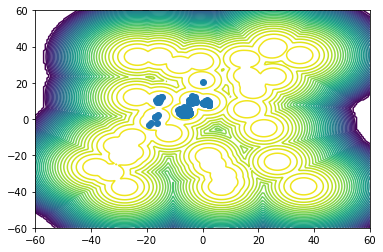

  3%|▎         | 1995/78125 [00:29<17:16, 73.45it/s]

Step 2000: Free energy 4.981427032546833 Log Normalizer estimate -3.467210380193528


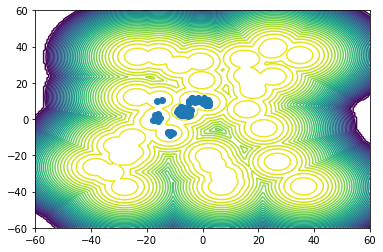

  4%|▍         | 2995/78125 [00:43<16:54, 74.03it/s]

Step 3000: Free energy 4.5830803311205885 Log Normalizer estimate -3.476487837310179


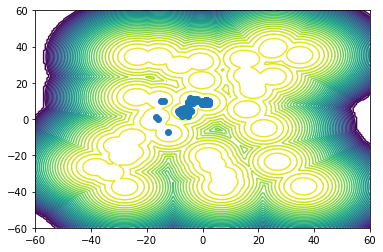

  5%|▌         | 3995/78125 [00:57<17:43, 69.69it/s]

Step 4000: Free energy 4.770057502718559 Log Normalizer estimate -3.882430058878586


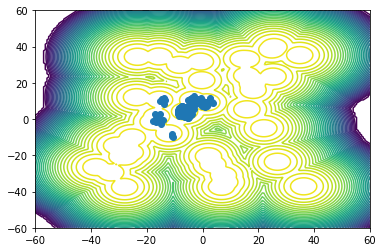

  6%|▋         | 4993/78125 [01:11<16:25, 74.20it/s]

Step 5000: Free energy 4.499170172583208 Log Normalizer estimate -3.7085242475751246


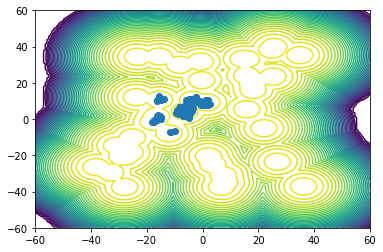

  8%|▊         | 6000/78125 [01:25<15:45, 76.25it/s]

Step 6000: Free energy 4.294142653187142 Log Normalizer estimate -2.6284481473166927


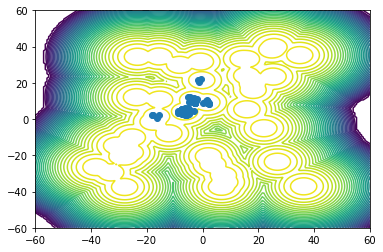

  9%|▉         | 6993/78125 [01:38<15:14, 77.77it/s]

Step 7000: Free energy 4.167837872059296 Log Normalizer estimate -3.6363651640559986


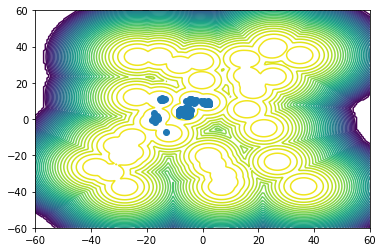

 10%|█         | 7996/78125 [01:52<15:01, 77.77it/s]

Step 8000: Free energy 4.000616420329432 Log Normalizer estimate -3.6014005654082286


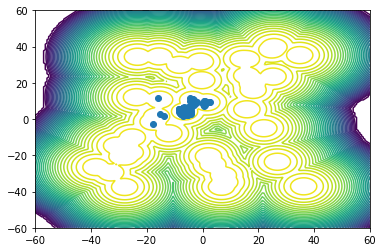

 12%|█▏        | 8994/78125 [02:05<14:49, 77.74it/s]

Step 9000: Free energy 4.181288199145648 Log Normalizer estimate -3.5598850010255525


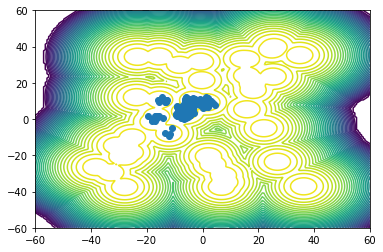

 13%|█▎        | 9995/78125 [02:18<14:40, 77.35it/s]

Step 10000: Free energy 3.883760023684526 Log Normalizer estimate -3.6439360416060733


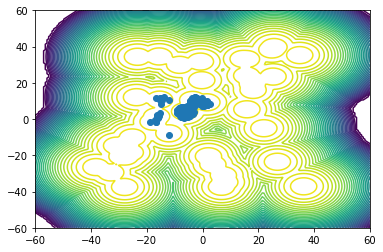

 14%|█▍        | 10996/78125 [02:32<14:22, 77.85it/s]

Step 11000: Free energy 3.7940235166741667 Log Normalizer estimate -3.3107108693976572


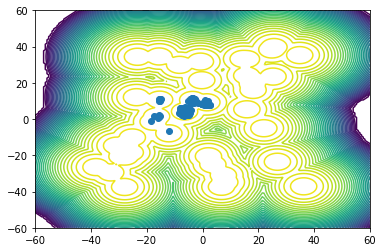

 15%|█▌        | 11997/78125 [02:45<14:11, 77.63it/s]

Step 12000: Free energy 3.75947836742389 Log Normalizer estimate -3.6657953628930606


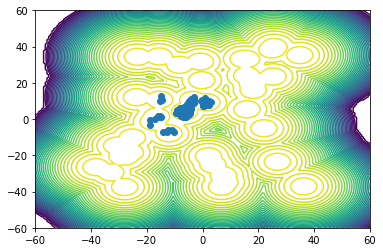

 17%|█▋        | 12999/78125 [02:58<13:46, 78.76it/s]

Step 13000: Free energy 3.7736643373588343 Log Normalizer estimate -3.673670930048166


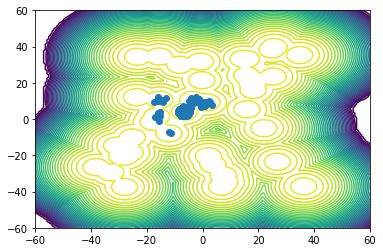

 18%|█▊        | 13993/78125 [03:11<13:26, 79.55it/s]

Step 14000: Free energy 3.6943792091487158 Log Normalizer estimate -3.6347017474670027


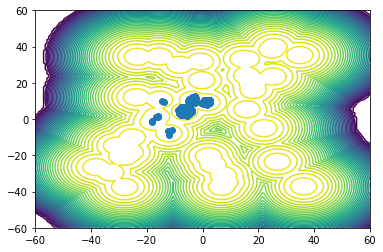

 19%|█▉        | 14997/78125 [03:24<13:31, 77.79it/s]

Step 15000: Free energy 3.6923440117763935 Log Normalizer estimate -3.6052099404729443


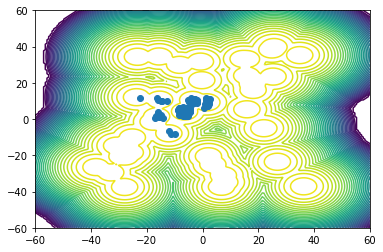

 20%|██        | 15993/78125 [03:37<13:18, 77.77it/s]

Step 16000: Free energy 3.667129843794651 Log Normalizer estimate -3.4131302837971944


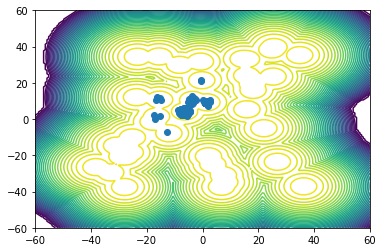

 22%|██▏       | 16993/78125 [03:50<13:17, 76.68it/s]

Step 17000: Free energy 3.9867075558208054 Log Normalizer estimate -2.243955202128908


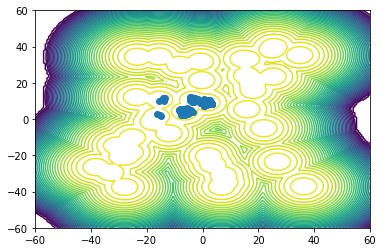

 23%|██▎       | 17996/78125 [04:03<12:46, 78.40it/s]

Step 18000: Free energy 3.709843169780262 Log Normalizer estimate -3.6383646604042257


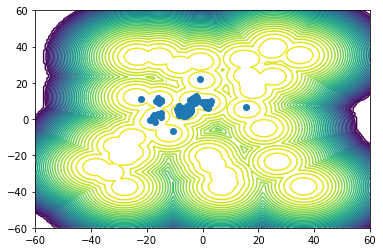

 24%|██▍       | 18998/78125 [04:16<12:31, 78.69it/s]

Step 19000: Free energy 3.7158217370952897 Log Normalizer estimate -3.5094113046430824


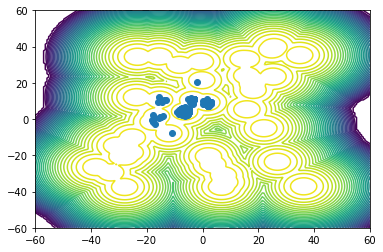

 26%|██▌       | 19993/78125 [04:29<12:23, 78.17it/s]

Step 20000: Free energy 3.695954696112546 Log Normalizer estimate -3.6120216249262125


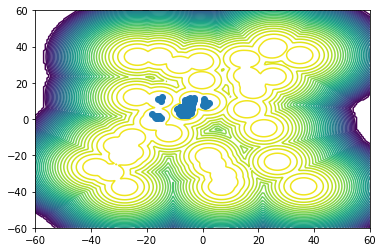

 27%|██▋       | 20994/78125 [04:43<12:31, 76.01it/s]

Step 21000: Free energy 3.736223538929349 Log Normalizer estimate -3.603585239579421


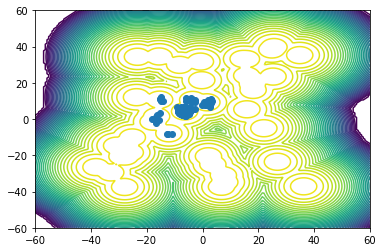

 28%|██▊       | 21993/78125 [04:56<12:11, 76.71it/s]

Step 22000: Free energy 3.7055068882633577 Log Normalizer estimate -3.608260709526329


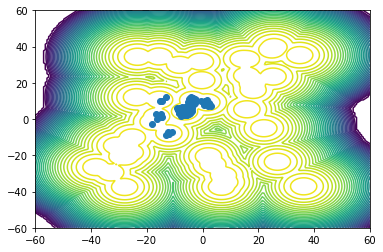

 29%|██▉       | 22999/78125 [05:09<11:46, 77.98it/s]

Step 23000: Free energy 3.7976119582233316 Log Normalizer estimate -3.6772787010936607


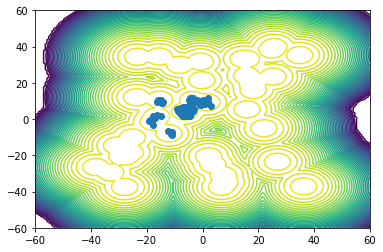

 31%|███       | 23997/78125 [05:22<11:38, 77.46it/s]

Step 24000: Free energy 3.7155509061926377 Log Normalizer estimate -3.644273149008602


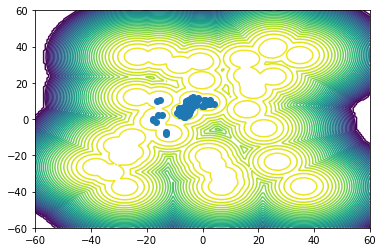

 32%|███▏      | 24996/78125 [05:36<11:19, 78.20it/s]

Step 25000: Free energy 3.739300461739128 Log Normalizer estimate -3.446743818869342


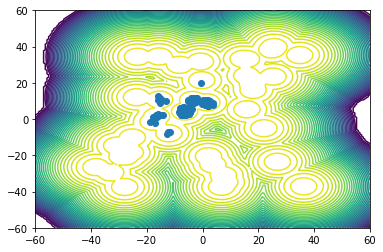

 33%|███▎      | 25995/78125 [05:49<11:39, 74.51it/s]

Step 26000: Free energy 3.7119501785789613 Log Normalizer estimate -3.6642051211605837


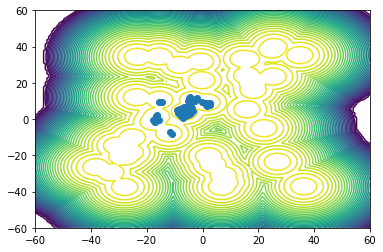

 35%|███▍      | 26997/78125 [06:02<11:06, 76.70it/s]

Step 27000: Free energy 3.6861616491694456 Log Normalizer estimate -3.5806438962339016


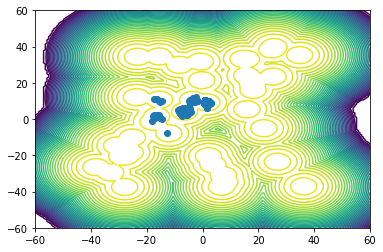

 36%|███▌      | 27995/78125 [06:15<10:49, 77.15it/s]

Step 28000: Free energy 3.7174076219018897 Log Normalizer estimate -3.5391439552857076


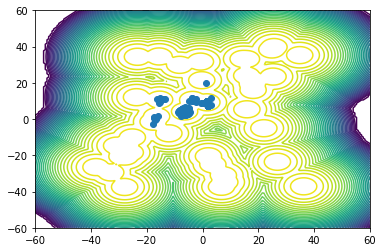

 37%|███▋      | 28995/78125 [06:29<11:26, 71.52it/s]

Step 29000: Free energy 3.7557981891316565 Log Normalizer estimate -3.6594966536473974


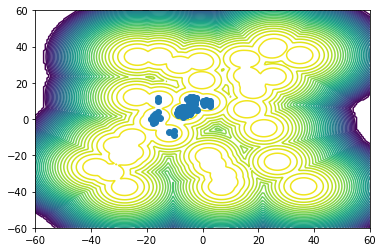

 38%|███▊      | 29995/78125 [06:43<10:28, 76.54it/s]

Step 30000: Free energy 3.713076258807866 Log Normalizer estimate -3.6001571738931393


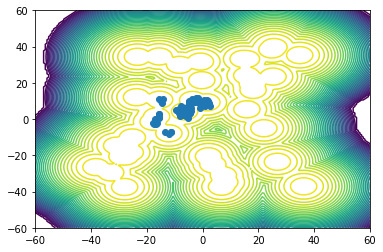

 40%|███▉      | 30998/78125 [06:56<10:11, 77.01it/s]

Step 31000: Free energy 3.7227691677317125 Log Normalizer estimate -3.556557032472581


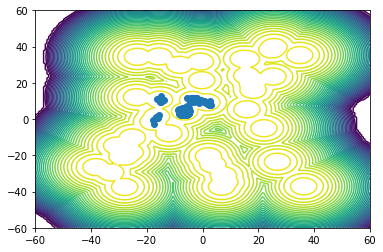

 41%|████      | 32000/78125 [07:09<10:06, 76.07it/s]

Step 32000: Free energy 3.7192699345388363 Log Normalizer estimate -3.6477634078422945


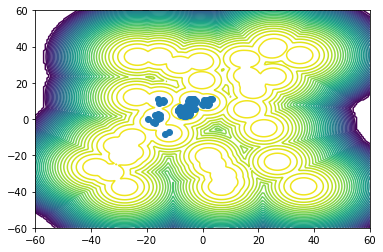

 42%|████▏     | 32997/78125 [07:23<09:50, 76.41it/s]

Step 33000: Free energy 3.742835603929933 Log Normalizer estimate -3.606356727928598


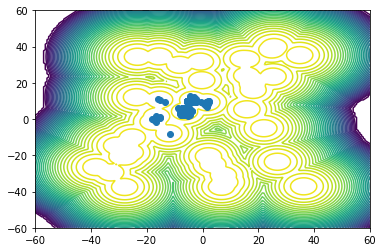

 44%|████▎     | 33997/78125 [07:36<09:42, 75.70it/s]

Step 34000: Free energy 3.6497315934551047 Log Normalizer estimate -3.568115785863551


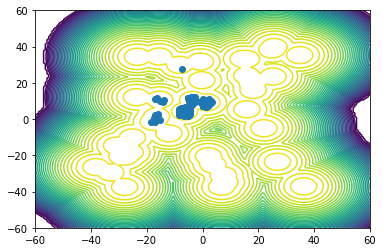

 45%|████▍     | 34999/78125 [07:50<09:31, 75.47it/s]

Step 35000: Free energy 3.6255869240589416 Log Normalizer estimate -3.3097080249708153


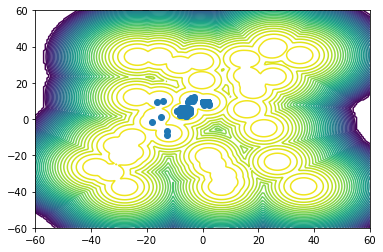

 46%|████▌     | 36000/78125 [08:03<09:13, 76.12it/s]

Step 36000: Free energy 3.651776941636804 Log Normalizer estimate -3.3100401320075523


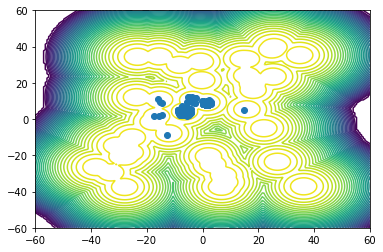

 47%|████▋     | 36993/78125 [08:17<08:54, 76.96it/s]

Step 37000: Free energy 3.6078689538695956 Log Normalizer estimate -2.1756159901906518


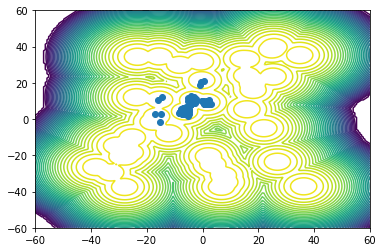

 49%|████▊     | 37994/78125 [08:30<08:45, 76.32it/s]

Step 38000: Free energy 3.70975619486019 Log Normalizer estimate -3.6733707245835516


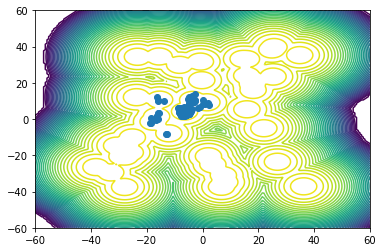

 50%|████▉     | 38994/78125 [08:44<08:26, 77.19it/s]

Step 39000: Free energy 3.7459862595564495 Log Normalizer estimate -3.59063778320835


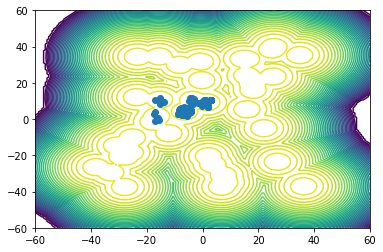

 51%|█████     | 39995/78125 [08:58<08:36, 73.76it/s]

Step 40000: Free energy 3.6730321070059775 Log Normalizer estimate -3.4769578754847466


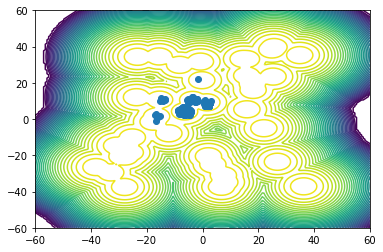

 52%|█████▏    | 40994/78125 [09:11<08:16, 74.71it/s]

Step 41000: Free energy 3.7197913283205626 Log Normalizer estimate -3.529573144593554


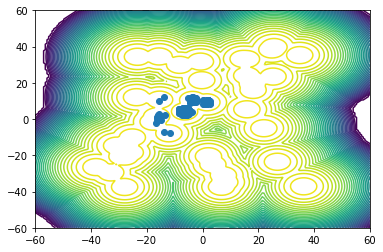

 54%|█████▍    | 41993/78125 [09:25<07:56, 75.81it/s]

Step 42000: Free energy 3.721213362853277 Log Normalizer estimate -3.504438809617108


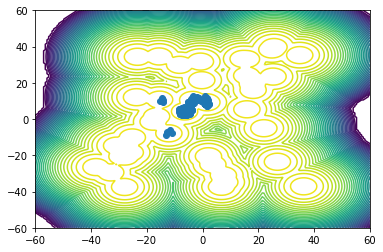

 55%|█████▌    | 42993/78125 [09:39<07:48, 74.93it/s]

Step 43000: Free energy 3.702259924151014 Log Normalizer estimate -3.407999320497111


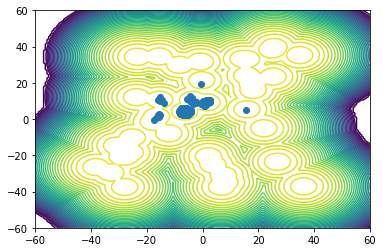

 56%|█████▋    | 43993/78125 [09:53<07:45, 73.38it/s]

Step 44000: Free energy 3.740002168924889 Log Normalizer estimate -3.6878098140936375


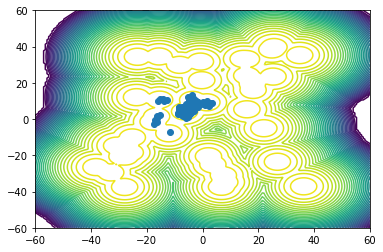

 58%|█████▊    | 45000/78125 [10:07<07:30, 73.46it/s]

Step 45000: Free energy 3.608703613505985 Log Normalizer estimate -2.8086475539260265


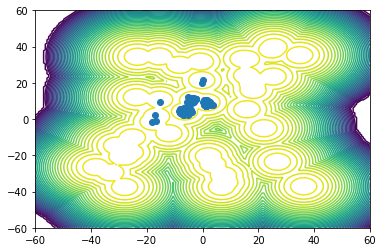

 59%|█████▉    | 46000/78125 [10:21<07:15, 73.77it/s]

Step 46000: Free energy 3.710409499213271 Log Normalizer estimate -3.5480881258128623


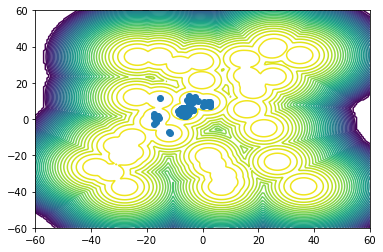

 60%|██████    | 47000/78125 [10:35<06:52, 75.37it/s]

Step 47000: Free energy 3.7018518298889527 Log Normalizer estimate -3.6081855883279683


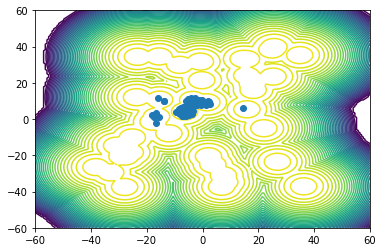

 61%|██████▏   | 48000/78125 [10:49<06:46, 74.13it/s]

Step 48000: Free energy 3.462798974946792 Log Normalizer estimate -3.0479705453663755


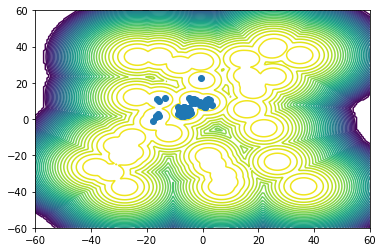

 63%|██████▎   | 49000/78125 [11:02<06:36, 73.44it/s]

Step 49000: Free energy 3.7001839729397714 Log Normalizer estimate -3.3394766845026638


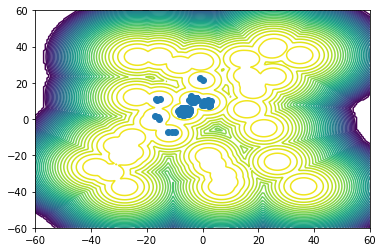

 64%|██████▍   | 50000/78125 [11:16<06:19, 74.04it/s]

Step 50000: Free energy 3.7140548059089555 Log Normalizer estimate -3.6342820522844184


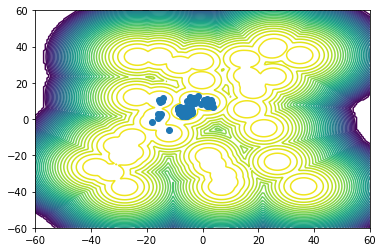

 65%|██████▌   | 51000/78125 [11:30<06:01, 74.99it/s]

Step 51000: Free energy 3.6827821272818833 Log Normalizer estimate -2.5783808142799742


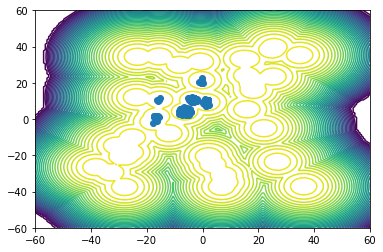

 67%|██████▋   | 52000/78125 [11:44<05:53, 73.95it/s]

Step 52000: Free energy 3.71866874997308 Log Normalizer estimate -3.6219639764590115


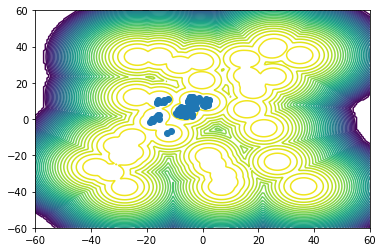

 68%|██████▊   | 53000/78125 [11:58<05:37, 74.43it/s]

Step 53000: Free energy 3.7286232983037255 Log Normalizer estimate -3.691951795310578


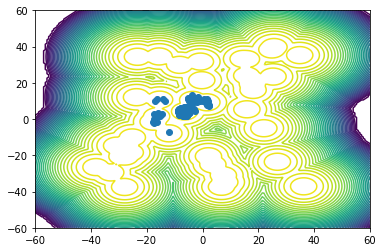

 69%|██████▉   | 54000/78125 [12:12<05:24, 74.31it/s]

Step 54000: Free energy 3.6781284536756305 Log Normalizer estimate -3.6453667935243015


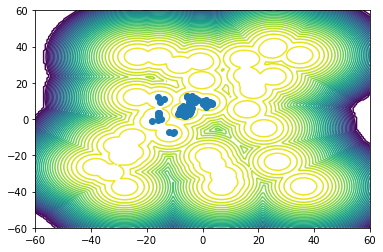

 70%|███████   | 55000/78125 [12:25<05:12, 73.92it/s]

Step 55000: Free energy 3.6989689381788438 Log Normalizer estimate -3.3787632256289344


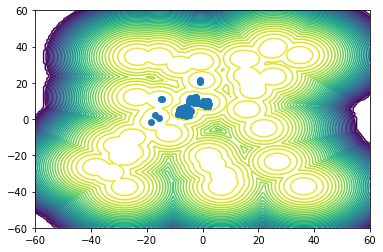

 72%|███████▏  | 56000/78125 [12:39<04:56, 74.58it/s]

Step 56000: Free energy 3.711387208116772 Log Normalizer estimate -3.431632288563131


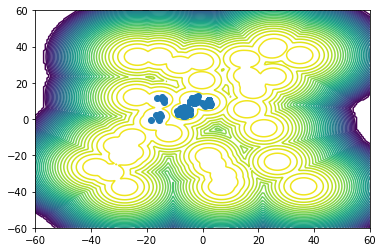

 73%|███████▎  | 56999/78125 [12:53<04:45, 73.87it/s]

Step 57000: Free energy 3.719872407531435 Log Normalizer estimate -3.508425409449101


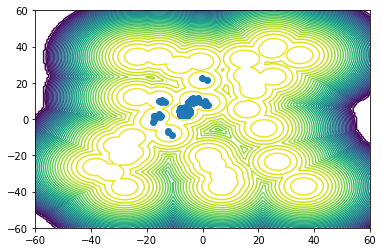

 74%|███████▍  | 57999/78125 [13:07<04:29, 74.81it/s]

Step 58000: Free energy 3.683913055576763 Log Normalizer estimate -3.1199206818613554


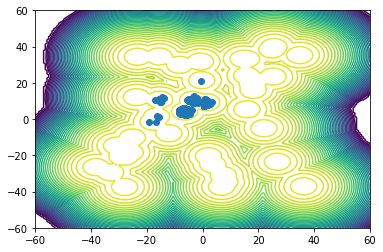

 76%|███████▌  | 58999/78125 [13:21<04:17, 74.15it/s]

Step 59000: Free energy 3.708033110950729 Log Normalizer estimate -3.383368325623768


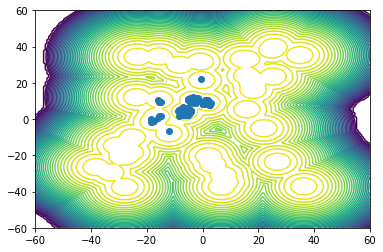

 77%|███████▋  | 59999/78125 [13:35<04:05, 73.91it/s]

Step 60000: Free energy 3.3181598574602464 Log Normalizer estimate -2.0607900427409174


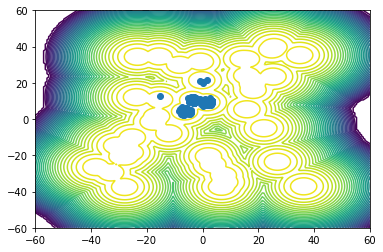

 78%|███████▊  | 60999/78125 [13:49<03:51, 73.91it/s]

Step 61000: Free energy 3.7100701266841742 Log Normalizer estimate -3.646991104700505


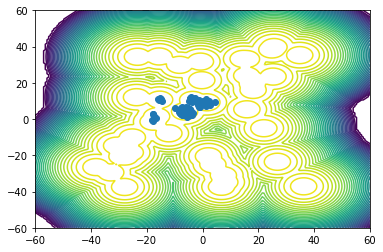

 79%|███████▉  | 61999/78125 [14:03<03:37, 74.19it/s]

Step 62000: Free energy 3.7211099793559175 Log Normalizer estimate -3.525937095982104


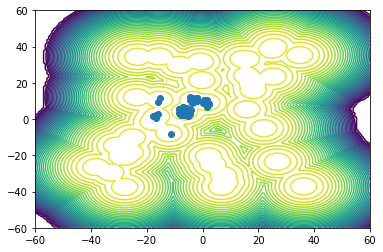

 81%|████████  | 62999/78125 [14:16<03:22, 74.76it/s]

Step 63000: Free energy 3.676831540875752 Log Normalizer estimate -2.8677126100240358


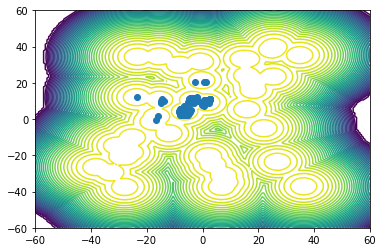

 82%|████████▏ | 63997/78125 [14:30<03:07, 75.45it/s]

Step 64000: Free energy 3.6879336610014324 Log Normalizer estimate -3.451008996850887


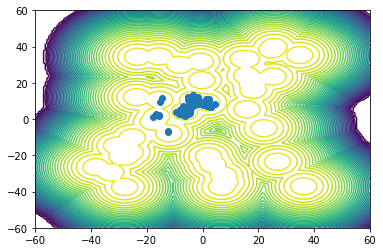

 83%|████████▎ | 64997/78125 [14:44<02:59, 73.09it/s]

Step 65000: Free energy 3.689481265255756 Log Normalizer estimate -3.644123024544516


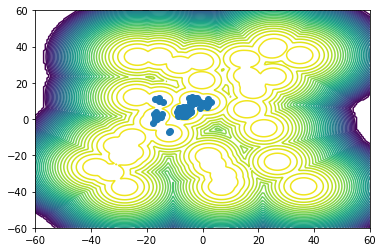

 84%|████████▍ | 65997/78125 [14:58<02:44, 73.60it/s]

Step 66000: Free energy 3.7280385735738264 Log Normalizer estimate -3.6843960029969924


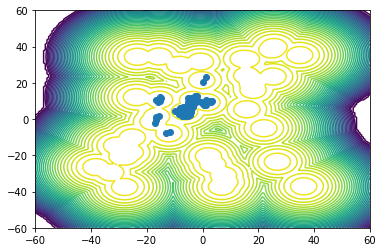

 86%|████████▌ | 66997/78125 [15:12<02:31, 73.22it/s]

Step 67000: Free energy 3.688458029907153 Log Normalizer estimate -3.5195030516781234


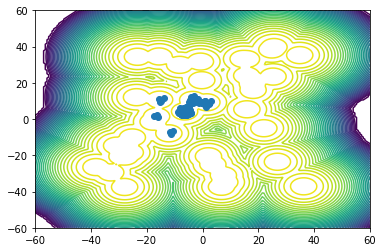

 87%|████████▋ | 67997/78125 [15:26<02:15, 74.99it/s]

Step 68000: Free energy 3.7304389697058022 Log Normalizer estimate -3.688407140390388


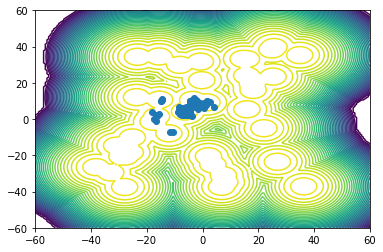

 88%|████████▊ | 68995/78125 [15:40<02:02, 74.58it/s]

Step 69000: Free energy 3.7496071877025265 Log Normalizer estimate -3.6329834481426566


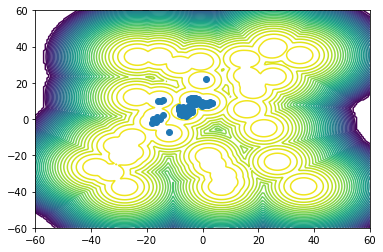

 90%|████████▉ | 69995/78125 [15:53<01:48, 74.91it/s]

Step 70000: Free energy 3.669950754099016 Log Normalizer estimate -3.5876901502932412


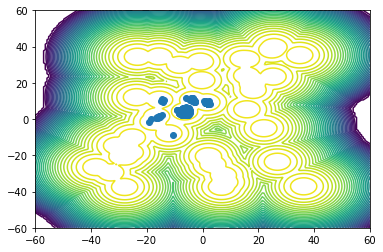

 91%|█████████ | 70995/78125 [16:07<01:34, 75.24it/s]

Step 71000: Free energy 3.694839527319724 Log Normalizer estimate -3.492102969812093


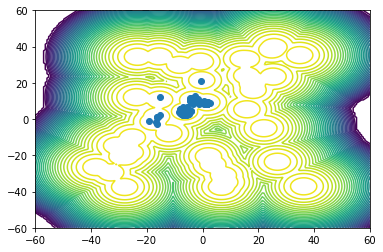

 92%|█████████▏| 71995/78125 [16:21<01:22, 74.49it/s]

Step 72000: Free energy 3.747341869253159 Log Normalizer estimate -3.5720517511910392


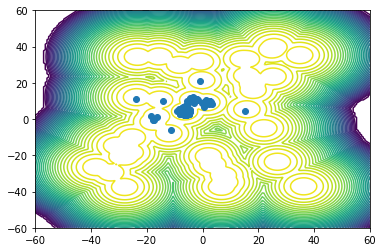

 93%|█████████▎| 72995/78125 [16:34<01:07, 75.94it/s]

Step 73000: Free energy 3.701469453485081 Log Normalizer estimate -3.6205695828897246


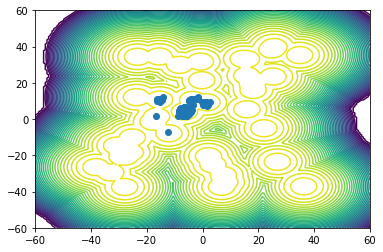

 95%|█████████▍| 73995/78125 [16:48<00:55, 74.47it/s]

Step 74000: Free energy 3.6873789057075967 Log Normalizer estimate -3.321240820576457


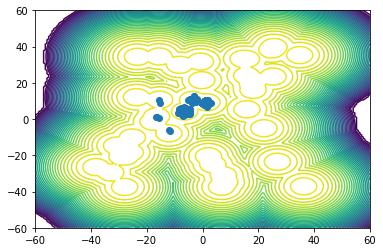

 96%|█████████▌| 74995/78125 [17:02<00:42, 74.40it/s]

Step 75000: Free energy 3.696002866242406 Log Normalizer estimate -3.6240386290391893


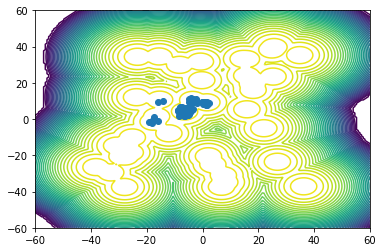

 97%|█████████▋| 75995/78125 [17:16<00:28, 74.43it/s]

Step 76000: Free energy 3.678820698190629 Log Normalizer estimate -3.642478721219441


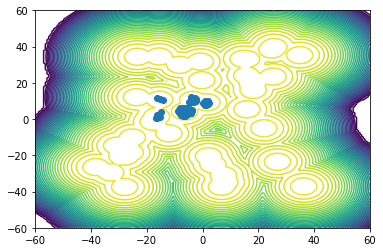

 99%|█████████▊| 76995/78125 [17:30<00:15, 74.97it/s]

Step 77000: Free energy 3.6801080856260526 Log Normalizer estimate -3.5919430380636133


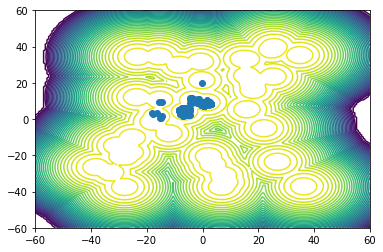

100%|█████████▉| 77995/78125 [17:44<00:01, 74.41it/s]

Step 78000: Free energy 3.7664027349268867 Log Normalizer estimate -3.4858249825971335


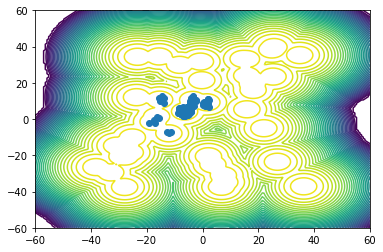

100%|██████████| 78125/78125 [17:46<00:00, 73.27it/s]


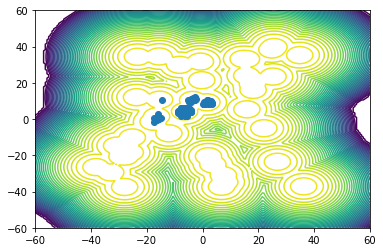

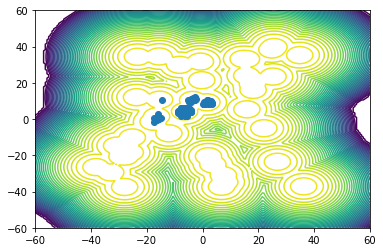

In [ ]:
results = run_experiment(exp_config)

In [ ]:
filename = "checkpoint_seed2"
transition_params = load_checkpoint(filename)
forward_pass_function = make_forward_pass_func(exp_config, transition_params=transition_params)
eval_info = evaluate(forward_pass_function)
print(eval_info)

/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:144: FutureWarning: jax.tree_flatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_flatten instead.
  leaves, treedef = jax.tree_flatten(tree)
/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:145: FutureWarning: jax.tree_unflatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_unflatten instead.
  return jax.tree_unflatten(treedef, leaves)


{'ess': DeviceArray(0.6638581, dtype=float64), 'bias': 0.9883927396232773, 'bias_unweighted': 0.9911236259682289}


In [ ]:
particle_state = forward_pass_function(jax.random.PRNGKey(0))
samples = np.array(particle_state.samples)
np.save(open(f"samples_seed{exp_config.seed}.np", "wb"), samples)

### Run third seed

In [ ]:
exp_config.seed = 3
exp_config.params_filename = "checkpoint_seed3"

/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:144: FutureWarning: jax.tree_flatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_flatten instead.
  leaves, treedef = jax.tree_flatten(tree)
/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:145: FutureWarning: jax.tree_unflatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_unflatten instead.
  return jax.tree_unflatten(treedef, leaves)
  0%|          | 0/78125 [00:00<?, ?it/s]

Step 0: Free energy 15.912745248245479 Log Normalizer estimate -7.768513124330564


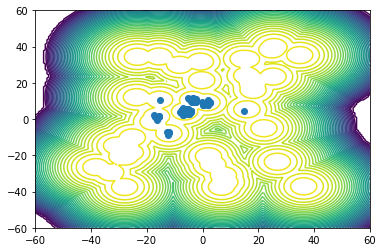

  1%|▏         | 993/78125 [00:15<18:08, 70.83it/s]

Step 1000: Free energy 6.013861391625444 Log Normalizer estimate -3.8010745161372768


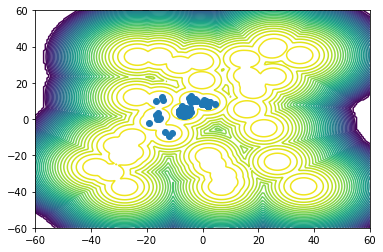

  3%|▎         | 1998/78125 [00:29<17:23, 72.97it/s]

Step 2000: Free energy 4.99993569550026 Log Normalizer estimate -3.752915016059534


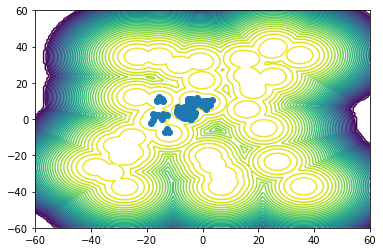

  4%|▍         | 2998/78125 [00:43<16:40, 75.13it/s]

Step 3000: Free energy 4.74301263608332 Log Normalizer estimate -3.605570077323204


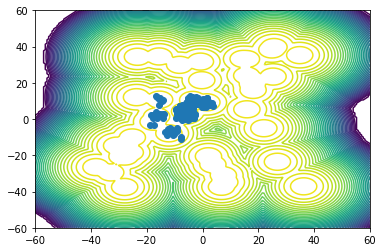

  5%|▌         | 3997/78125 [00:57<16:29, 74.95it/s]

Step 4000: Free energy 4.729092500044136 Log Normalizer estimate -3.6985560133328628


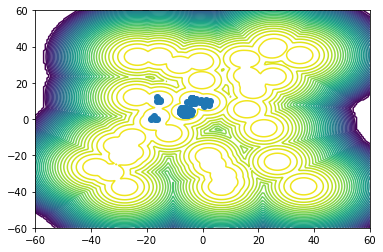

  6%|▋         | 4997/78125 [01:10<16:13, 75.09it/s]

Step 5000: Free energy 4.373364069598249 Log Normalizer estimate -3.627953287865572


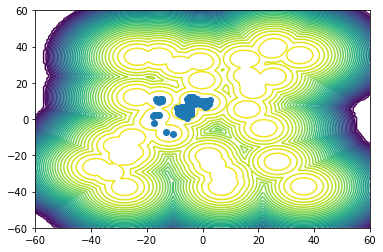

  8%|▊         | 5997/78125 [01:24<15:35, 77.08it/s]

Step 6000: Free energy 4.649428679492596 Log Normalizer estimate -3.505421425227132


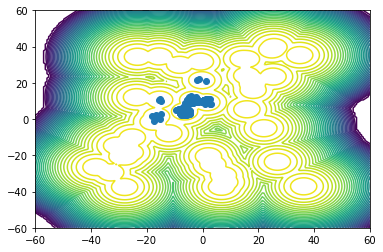

  9%|▉         | 7000/78125 [01:37<15:29, 76.49it/s]

Step 7000: Free energy 4.246815070152016 Log Normalizer estimate -3.755971974607223


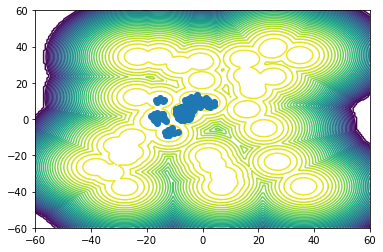

 10%|█         | 8000/78125 [01:50<14:59, 77.96it/s]

Step 8000: Free energy 3.93326869384658 Log Normalizer estimate -1.8865675116890008


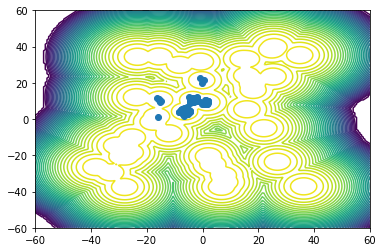

 12%|█▏        | 9000/78125 [02:03<14:43, 78.25it/s]

Step 9000: Free energy 3.973947683106342 Log Normalizer estimate -3.683979857788671


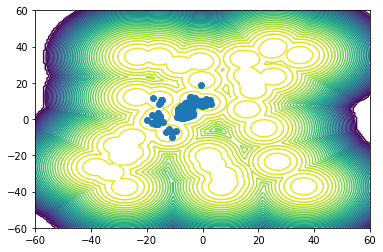

 13%|█▎        | 9997/78125 [02:16<14:34, 77.90it/s]

Step 10000: Free energy 3.849061471767305 Log Normalizer estimate -3.637758772310148


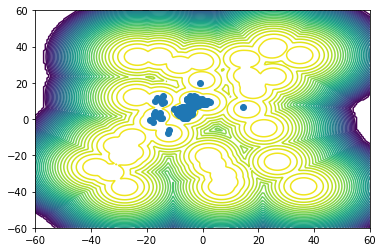

 14%|█▍        | 11000/78125 [02:30<14:08, 79.14it/s]

Step 11000: Free energy 3.8176332251574046 Log Normalizer estimate -3.5762119471974687


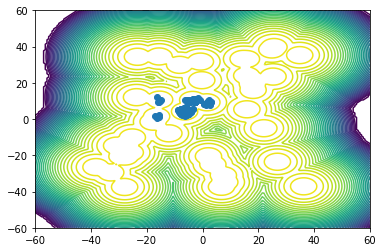

 15%|█▌        | 11996/78125 [02:43<14:05, 78.20it/s]

Step 12000: Free energy 3.7907424639310046 Log Normalizer estimate -3.4358875357564163


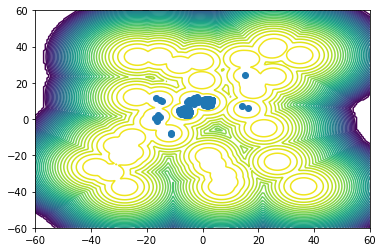

 17%|█▋        | 12994/78125 [02:56<13:55, 77.95it/s]

Step 13000: Free energy 3.747140208220288 Log Normalizer estimate -3.6837630960046868


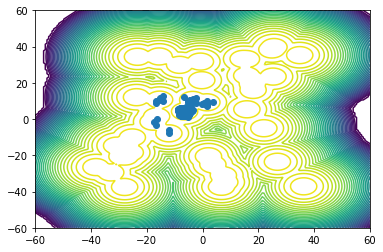

 18%|█▊        | 13993/78125 [03:09<13:40, 78.15it/s]

Step 14000: Free energy 3.729526072894517 Log Normalizer estimate -3.690054356587508


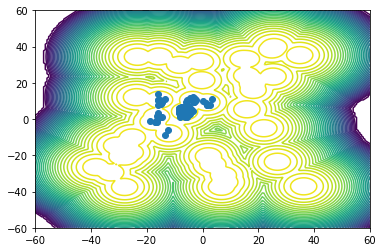

 19%|█▉        | 14994/78125 [03:22<13:30, 77.90it/s]

Step 15000: Free energy 3.6915412073582274 Log Normalizer estimate -3.5614506462236895


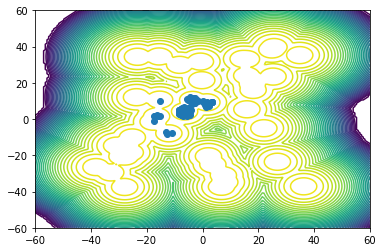

 20%|██        | 15998/78125 [03:35<13:22, 77.46it/s]

Step 16000: Free energy 3.4991451297335514 Log Normalizer estimate -3.1132449691507826


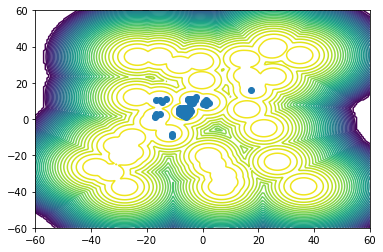

 22%|██▏       | 16999/78125 [03:48<13:08, 77.53it/s]

Step 17000: Free energy 3.630620071163797 Log Normalizer estimate -3.322182489902487


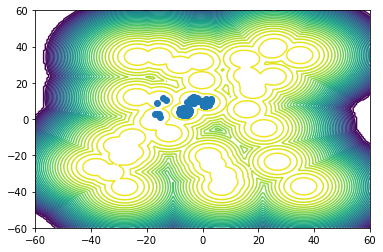

 23%|██▎       | 17994/78125 [04:01<12:56, 77.45it/s]

Step 18000: Free energy 3.7227218393970993 Log Normalizer estimate -3.689668251936216


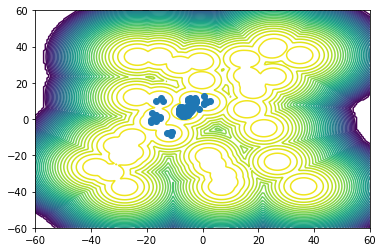

 24%|██▍       | 18999/78125 [04:14<12:32, 78.57it/s]

Step 19000: Free energy 3.7361915025876336 Log Normalizer estimate -3.346120120527586


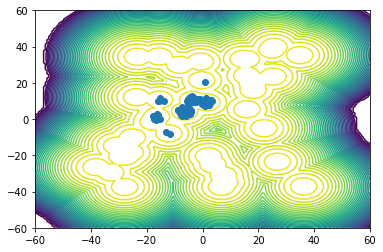

 26%|██▌       | 19998/78125 [04:28<12:46, 75.84it/s]

Step 20000: Free energy 3.7099981404917433 Log Normalizer estimate -3.640362663456189


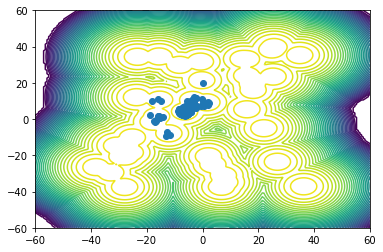

 27%|██▋       | 21000/78125 [04:41<12:15, 77.69it/s]

Step 21000: Free energy 3.697687440632558 Log Normalizer estimate -3.667720708589939


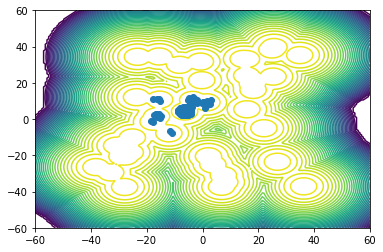

 28%|██▊       | 21998/78125 [04:54<12:11, 76.77it/s]

Step 22000: Free energy 3.686351909922389 Log Normalizer estimate -3.631822877894013


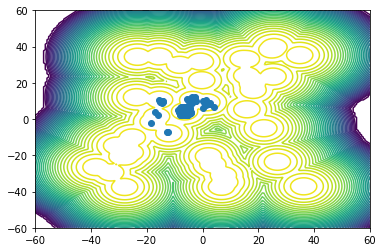

 29%|██▉       | 22994/78125 [05:07<11:48, 77.84it/s]

Step 23000: Free energy 3.7467457681890792 Log Normalizer estimate -2.9393865066731557


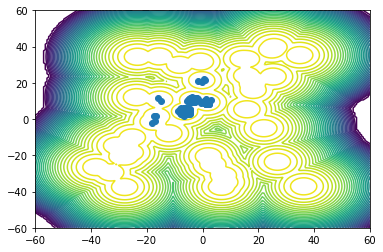

 31%|███       | 23997/78125 [05:20<11:33, 78.00it/s]

Step 24000: Free energy 3.68137013427508 Log Normalizer estimate -3.247462221215537


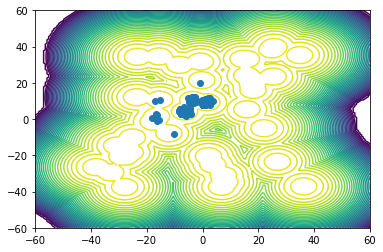

 32%|███▏      | 24998/78125 [05:34<12:22, 71.60it/s]

Step 25000: Free energy 3.686985017155285 Log Normalizer estimate -3.3537498715487395


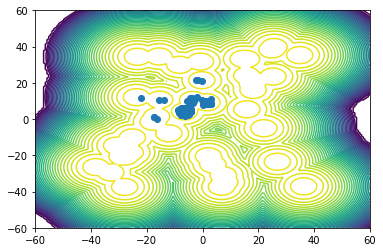

 33%|███▎      | 25998/78125 [05:47<11:20, 76.65it/s]

Step 26000: Free energy 3.7097924718356614 Log Normalizer estimate -2.8759976418639477


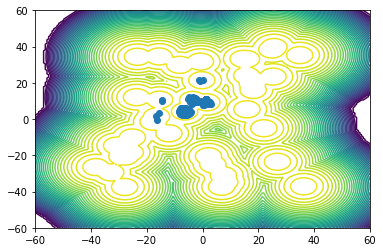

 35%|███▍      | 26993/78125 [06:01<11:14, 75.81it/s]

Step 27000: Free energy 3.742268217388016 Log Normalizer estimate -3.630731147358313


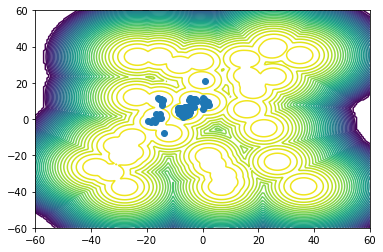

 36%|███▌      | 27996/78125 [06:14<10:41, 78.19it/s]

Step 28000: Free energy 3.7120050570388745 Log Normalizer estimate -3.6174919980339517


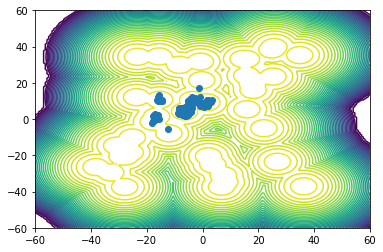

 37%|███▋      | 28997/78125 [06:28<10:44, 76.27it/s]

Step 29000: Free energy 3.4956963460118002 Log Normalizer estimate -2.7814989452903642


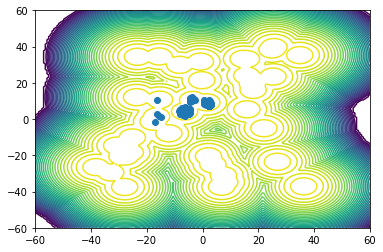

 38%|███▊      | 29995/78125 [06:41<10:23, 77.24it/s]

Step 30000: Free energy 3.6965275482628392 Log Normalizer estimate -3.588862878359132


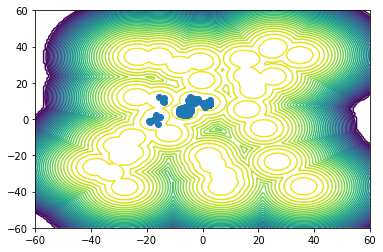

 40%|███▉      | 30998/78125 [06:54<10:18, 76.16it/s]

Step 31000: Free energy 3.5676410165910424 Log Normalizer estimate -3.3986167402974488


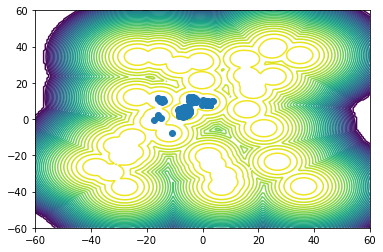

 41%|████      | 31999/78125 [07:08<10:07, 75.96it/s]

Step 32000: Free energy 3.2044617912567066 Log Normalizer estimate -0.6013910905756878


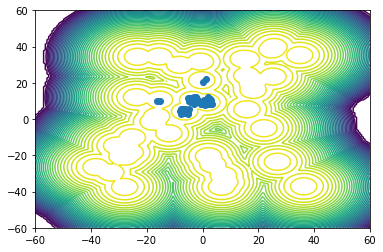

 42%|████▏     | 32994/78125 [07:21<09:49, 76.61it/s]

Step 33000: Free energy 3.3316832006793593 Log Normalizer estimate -2.6081219815865824


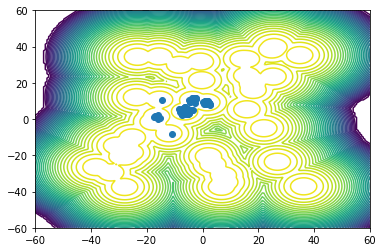

 44%|████▎     | 33996/78125 [07:35<09:50, 74.68it/s]

Step 34000: Free energy 3.7272454435865443 Log Normalizer estimate -3.6587881347648343


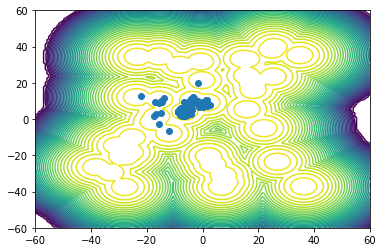

 45%|████▍     | 35000/78125 [07:48<09:27, 75.93it/s]

Step 35000: Free energy 3.7179940619790663 Log Normalizer estimate -3.6252906542397243


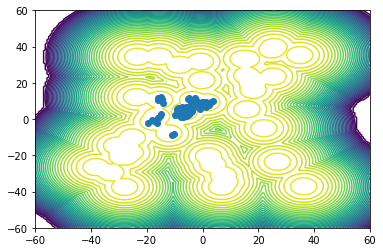

 46%|████▌     | 35993/78125 [08:01<09:07, 77.01it/s]

Step 36000: Free energy 3.705094591489069 Log Normalizer estimate -3.660638330191313


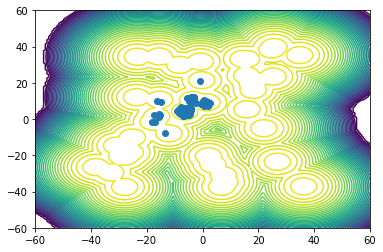

 47%|████▋     | 36995/78125 [08:15<08:53, 77.11it/s]

Step 37000: Free energy 3.6896450715163143 Log Normalizer estimate -3.5464734912047877


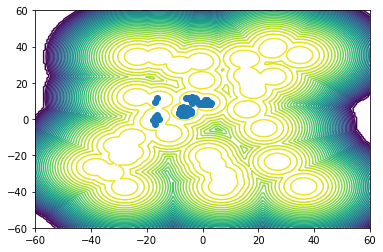

 49%|████▊     | 37996/78125 [08:29<09:00, 74.21it/s]

Step 38000: Free energy 3.707593776782904 Log Normalizer estimate -3.6814436683454552


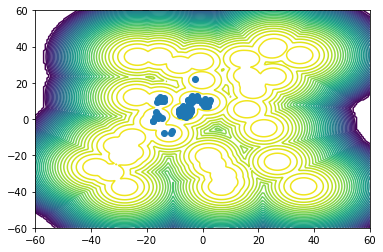

 50%|████▉     | 38995/78125 [08:43<08:49, 73.84it/s]

Step 39000: Free energy 2.9466555974339705 Log Normalizer estimate -2.3170658347862743


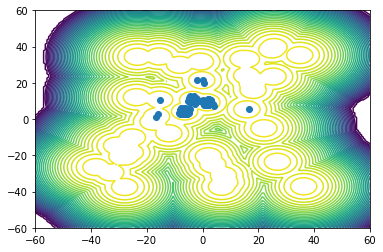

 51%|█████     | 39995/78125 [08:57<08:41, 73.10it/s]

Step 40000: Free energy 3.6976202846524897 Log Normalizer estimate -3.618662027293933


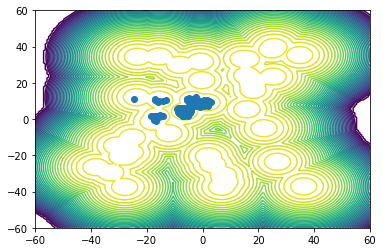

 52%|█████▏    | 40993/78125 [09:10<08:17, 74.64it/s]

Step 41000: Free energy 3.7076471536963727 Log Normalizer estimate -3.5974512498274525


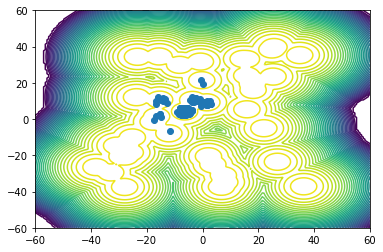

 54%|█████▍    | 41993/78125 [09:24<08:06, 74.26it/s]

Step 42000: Free energy 3.6943352194976953 Log Normalizer estimate -3.6119115727852407


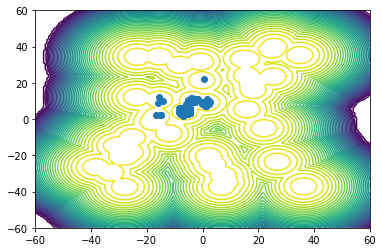

 55%|█████▌    | 42996/78125 [09:39<09:25, 62.10it/s]

Step 43000: Free energy 3.667614950980621 Log Normalizer estimate -3.568094824327936


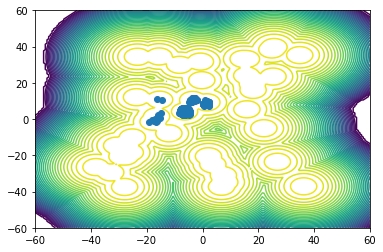

 56%|█████▋    | 43995/78125 [09:53<07:43, 73.69it/s]

Step 44000: Free energy 3.6982894144102385 Log Normalizer estimate -3.6760300190162463


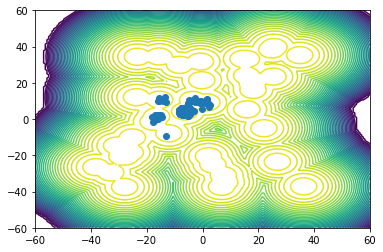

 58%|█████▊    | 44995/78125 [10:07<07:20, 75.14it/s]

Step 45000: Free energy 3.471403482174856 Log Normalizer estimate -2.747900420200158


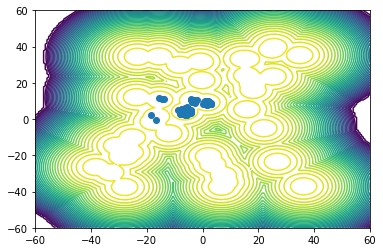

 59%|█████▉    | 45995/78125 [10:21<07:21, 72.82it/s]

Step 46000: Free energy 3.7091364613787086 Log Normalizer estimate -3.6604034522715656


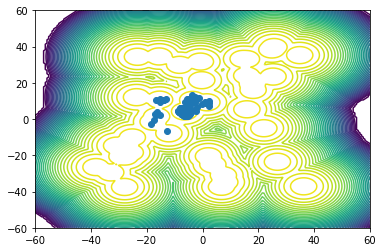

 60%|██████    | 46994/78125 [10:35<06:59, 74.13it/s]

Step 47000: Free energy 3.708145729416919 Log Normalizer estimate -3.2256405953935063


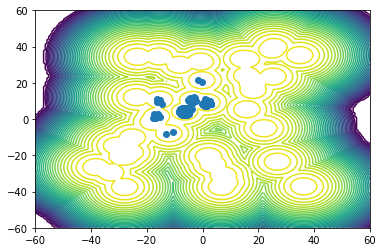

 61%|██████▏   | 47994/78125 [10:48<06:46, 74.13it/s]

Step 48000: Free energy 3.757274241105465 Log Normalizer estimate -3.6558064605326788


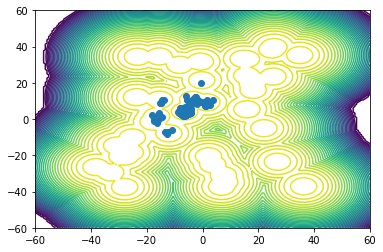

 63%|██████▎   | 48994/78125 [11:02<06:36, 73.42it/s]

Step 49000: Free energy 3.124174563219583 Log Normalizer estimate -2.242073579096891


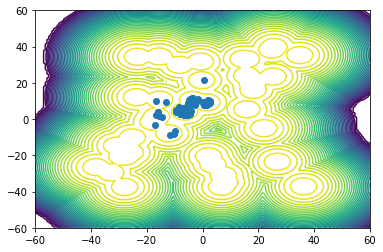

 64%|██████▍   | 49994/78125 [11:16<06:11, 75.64it/s]

Step 50000: Free energy 3.453034793416256 Log Normalizer estimate -2.9594480466789985


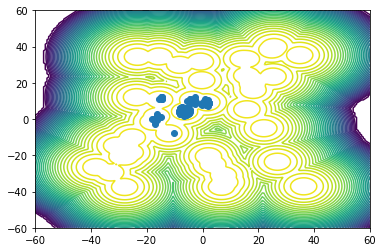

 65%|██████▌   | 50993/78125 [11:30<06:08, 73.65it/s]

Step 51000: Free energy 3.6830970984077975 Log Normalizer estimate -3.6147693736652444


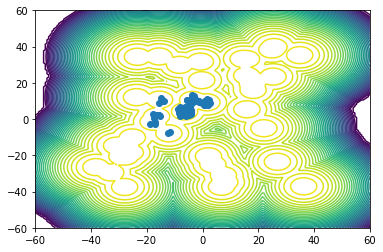

 67%|██████▋   | 52000/78125 [11:44<05:58, 72.87it/s]

Step 52000: Free energy 3.730413972402026 Log Normalizer estimate -3.644032546823018


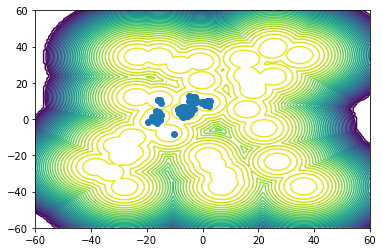

 68%|██████▊   | 53000/78125 [11:58<05:40, 73.73it/s]

Step 53000: Free energy 3.6914830422011127 Log Normalizer estimate -3.620031010312945


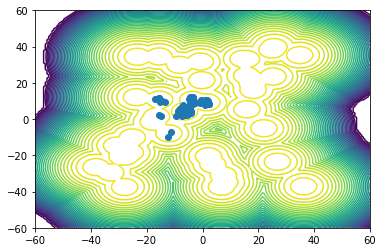

 69%|██████▉   | 54000/78125 [12:12<05:19, 75.62it/s]

Step 54000: Free energy 3.7414131355638496 Log Normalizer estimate -3.5861406868093306


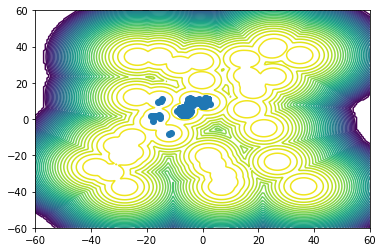

 70%|███████   | 55000/78125 [12:26<05:22, 71.63it/s]

Step 55000: Free energy 3.625709582863605 Log Normalizer estimate -3.1525174230295514


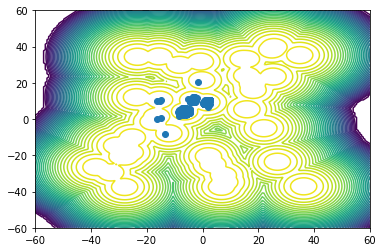

 72%|███████▏  | 55999/78125 [12:40<05:00, 73.64it/s]

Step 56000: Free energy 3.6905866722364014 Log Normalizer estimate -3.474647383910752


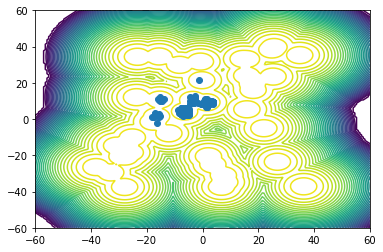

 73%|███████▎  | 56999/78125 [12:53<04:40, 75.36it/s]

Step 57000: Free energy 3.6925096106789628 Log Normalizer estimate -3.632668090849034


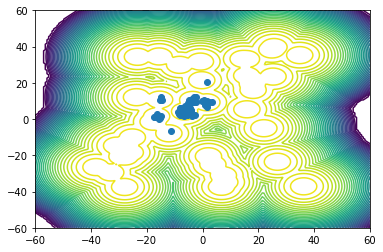

 74%|███████▍  | 57999/78125 [13:07<04:29, 74.60it/s]

Step 58000: Free energy 3.345249276185677 Log Normalizer estimate -2.493141461060082


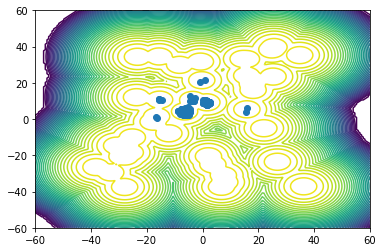

 76%|███████▌  | 58999/78125 [13:21<04:25, 72.16it/s]

Step 59000: Free energy 3.7108161585547546 Log Normalizer estimate -3.6409556215358467


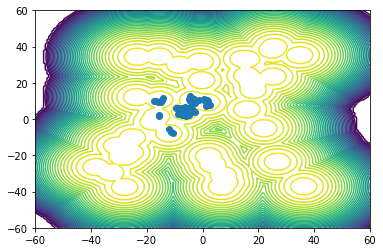

 77%|███████▋  | 59998/78125 [13:35<04:06, 73.46it/s]

Step 60000: Free energy 3.714424542597163 Log Normalizer estimate -3.6567743882496853


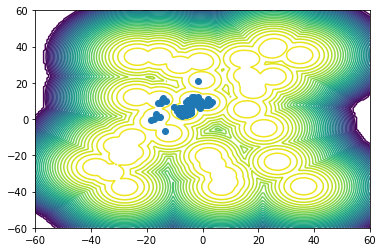

 78%|███████▊  | 60998/78125 [13:49<03:50, 74.35it/s]

Step 61000: Free energy 3.704032148877615 Log Normalizer estimate -3.6470242352409814


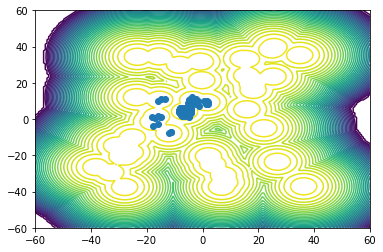

 79%|███████▉  | 61998/78125 [14:03<03:30, 76.72it/s]

Step 62000: Free energy 3.6831510359092743 Log Normalizer estimate -3.444219361589517


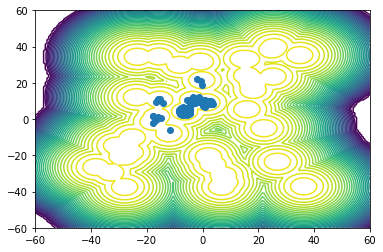

 81%|████████  | 62999/78125 [14:17<03:29, 72.04it/s]

Step 63000: Free energy 3.706378049048637 Log Normalizer estimate -3.6118011208057705


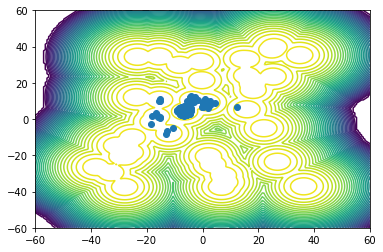

 82%|████████▏ | 63999/78125 [14:31<03:11, 73.82it/s]

Step 64000: Free energy 3.717301106535288 Log Normalizer estimate -3.6757056814685525


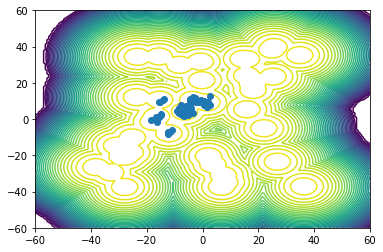

 83%|████████▎ | 64998/78125 [14:45<02:55, 74.89it/s]

Step 65000: Free energy 3.4639611118034974 Log Normalizer estimate -2.740587960572342


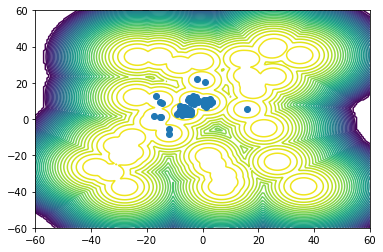

 84%|████████▍ | 65998/78125 [14:58<02:41, 74.99it/s]

Step 66000: Free energy 3.68674786102435 Log Normalizer estimate -3.6333180749607177


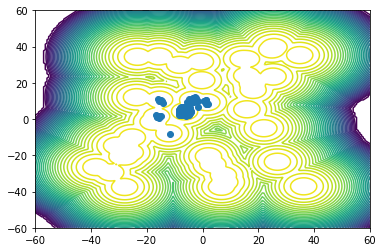

 86%|████████▌ | 66998/78125 [15:12<02:24, 77.19it/s]

Step 67000: Free energy 3.75884562509472 Log Normalizer estimate -3.333636073906895


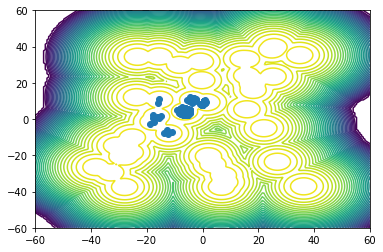

 87%|████████▋ | 67998/78125 [15:26<02:16, 74.17it/s]

Step 68000: Free energy 3.6885815307210645 Log Normalizer estimate -3.6252021971520945


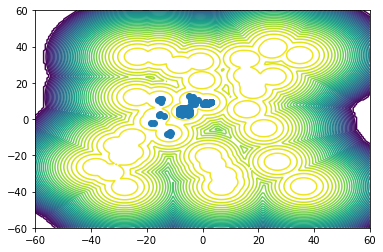

 88%|████████▊ | 68998/78125 [15:40<02:01, 74.89it/s]

Step 69000: Free energy 2.8027835791742977 Log Normalizer estimate -1.7878065283889546


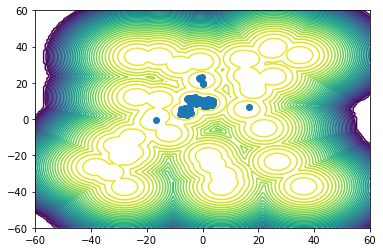

 90%|████████▉ | 69998/78125 [15:53<01:48, 74.91it/s]

Step 70000: Free energy 3.67854994694812 Log Normalizer estimate -3.5711892184670573


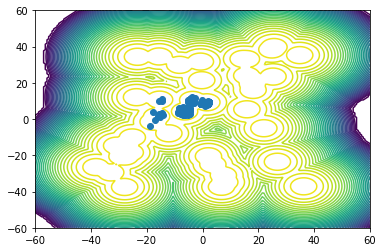

 91%|█████████ | 70998/78125 [16:07<01:36, 73.54it/s]

Step 71000: Free energy 3.758046614498692 Log Normalizer estimate -3.25838673052181


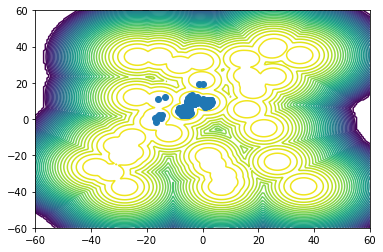

 92%|█████████▏| 71998/78125 [16:21<01:21, 75.09it/s]

Step 72000: Free energy 3.749607782370015 Log Normalizer estimate -3.6090838039497424


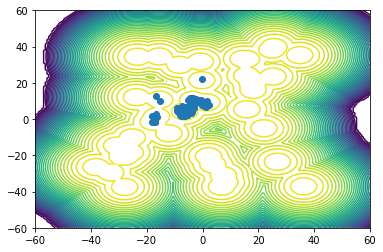

 93%|█████████▎| 72999/78125 [16:35<01:08, 74.83it/s]

Step 73000: Free energy 3.69630565371817 Log Normalizer estimate -3.526232727784297


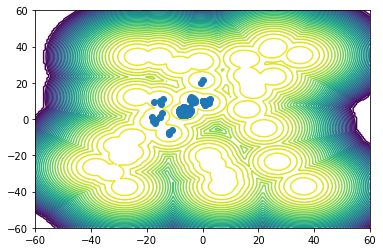

 95%|█████████▍| 73999/78125 [16:48<00:56, 73.59it/s]

Step 74000: Free energy 3.710446409624682 Log Normalizer estimate -3.575316170985884


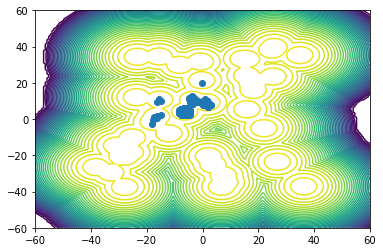

 96%|█████████▌| 74998/78125 [17:02<00:42, 74.10it/s]

Step 75000: Free energy 3.655946273846025 Log Normalizer estimate -3.3737609475003474


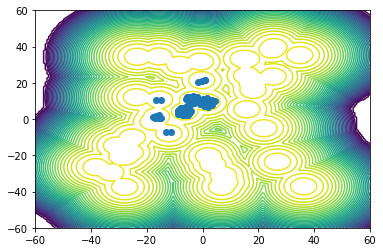

 97%|█████████▋| 75997/78125 [17:16<00:28, 75.69it/s]

Step 76000: Free energy 3.619593873821753 Log Normalizer estimate -3.0354742343302368


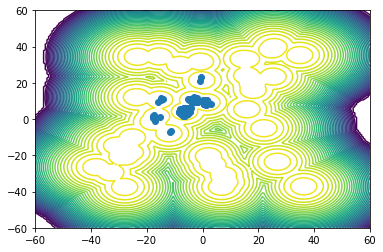

 99%|█████████▊| 76998/78125 [17:30<00:15, 73.09it/s]

Step 77000: Free energy 3.547539220869922 Log Normalizer estimate -3.291853247612538


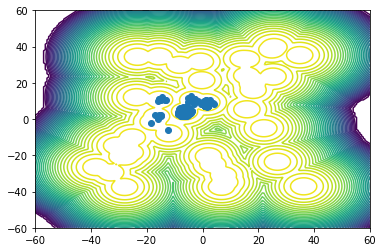

100%|█████████▉| 77996/78125 [17:44<00:01, 73.48it/s]

Step 78000: Free energy 3.5592869331398216 Log Normalizer estimate -3.1513551155780286


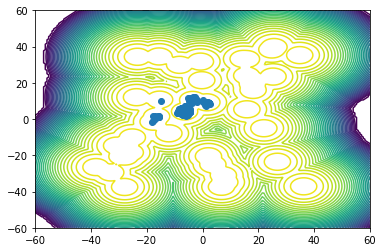

100%|██████████| 78125/78125 [17:46<00:00, 73.26it/s]


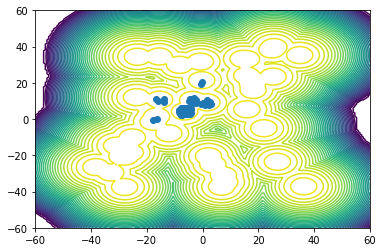

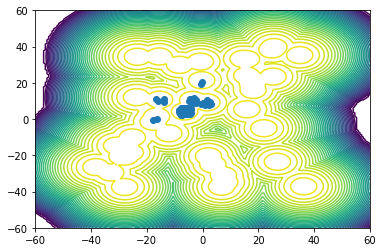

In [ ]:
results = run_experiment(exp_config)

In [ ]:
filename = "checkpoint_seed3"
transition_params = load_checkpoint(filename)
forward_pass_function = make_forward_pass_func(exp_config, transition_params=transition_params)
eval_info = evaluate(forward_pass_function)
print(eval_info)

/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:144: FutureWarning: jax.tree_flatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_flatten instead.
  leaves, treedef = jax.tree_flatten(tree)
/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:145: FutureWarning: jax.tree_unflatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_unflatten instead.
  return jax.tree_unflatten(treedef, leaves)


{'ess': DeviceArray(0.58594045, dtype=float64), 'bias': 0.9881609388468375, 'bias_unweighted': 0.9911598542365896}


In [ ]:
particle_state = forward_pass_function(jax.random.PRNGKey(0))
samples = np.array(particle_state.samples)
np.save(open(f"samples_seed{exp_config.seed}.np", "wb"), samples)

# Evaluation of trained models

In [10]:
filename = "checkpoint_seed1"
transition_params = load_checkpoint(filename)
forward_pass_function = make_forward_pass_func(exp_config, transition_params=transition_params)
eval_info_seed1 = evaluate(forward_pass_function)
print(eval_info_seed1)

FileNotFoundError: ignored

In [ ]:
filename = "checkpoint_seed2"
transition_params = load_checkpoint(filename)
forward_pass_function = make_forward_pass_func(exp_config, transition_params=transition_params)
eval_info_seed2 = evaluate(forward_pass_function)
print(eval_info_seed2)

/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:144: FutureWarning: jax.tree_flatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_flatten instead.
  leaves, treedef = jax.tree_flatten(tree)
/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:145: FutureWarning: jax.tree_unflatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_unflatten instead.
  return jax.tree_unflatten(treedef, leaves)


{'ess': DeviceArray(0.6638581, dtype=float64), 'bias': 0.9883927396232773, 'bias_unweighted': 0.9911236259682289}


In [ ]:
filename = "checkpoint_seed3"
transition_params = load_checkpoint(filename)
forward_pass_function = make_forward_pass_func(exp_config, transition_params=transition_params)
eval_info_seed3 = evaluate(forward_pass_function)
print(eval_info_seed3)

/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:144: FutureWarning: jax.tree_flatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_flatten instead.
  leaves, treedef = jax.tree_flatten(tree)
/usr/local/lib/python3.7/dist-packages/haiku/_src/data_structures.py:145: FutureWarning: jax.tree_unflatten is deprecated, and will be removed in a future release. Use jax.tree_util.tree_unflatten instead.
  return jax.tree_unflatten(treedef, leaves)


{'ess': DeviceArray(0.58594045, dtype=float64), 'bias': 0.9881609388468375, 'bias_unweighted': 0.9911598542365896}


In [ ]:
eval_info = {key: np.asarray([eval_info_seed1[key], eval_info_seed2[key], eval_info_seed3[key]]) for key in eval_info_seed1.keys()}

In [ ]:
{key: np.mean(val) for key, val in eval_info.items()}

{'ess': 0.6025323283556668,
 'bias': 0.9882723715614598,
 'bias_unweighted': 0.9911365442630357}

In [ ]:
import scipy

In [ ]:
{key: scipy.stats.sem(val, ddof=0) for key, val in eval_info.items()}

{'ess': 0.02589993943362814,
 'bias': 5.475760791717855e-05,
 'bias_unweighted': 9.534872806814258e-06}